## Step 3: Detect places with amber mining

In this notebook I'll show example how to use model trained in previous steps to detect interesting satellite images. 

See also [Step 1](step1.ipynb) and [Step 2](step2.ipynb). 

In [23]:
from __future__ import print_function
#from sklearn.externals import joblib
import joblib
import matplotlib.pyplot as plt
import numpy as np

from skimage import io
from skimage.segmentation import slic
from skimage.segmentation import mark_boundaries
from skimage.util import img_as_float
from scipy import misc
import numpy as np
from skimage import io, img_as_float
from skimage.segmentation import slic
from skimage.measure import regionprops
from keras.applications.resnet50 import preprocess_input, ResNet50
from PIL import Image
import xgboost as xgb

from PIL import Image
from skimage.measure import regionprops

import sys
import os

# uncomment line below if you use TensorFlow with GPU support, ie CUDA libraries etc
# os.environ["CUDA_VISIBLE_DEVICES"]="0" # to allocate only one TensorFLow device

import tensorflow as tf
from keras.applications.resnet50 import ResNet50
from keras.preprocessing import image
from keras.applications.resnet50 import preprocess_input, decode_predictions



import xgboost as xgb



In [24]:
#  load classifier (XGBoost) which we've created in previous steps
#_clf = joblib.load('versions/xgb_model.pkl')
#_clf = joblib.load('./versions/xgb_model.pkl')
#_clf = joblib.load('./model/versions/xgb_model.pkl')
# uncomment to load production model used in our project
# _clf = joblib.load('./versions/xgb_model_v003.pkl')


# Print the current working directory
print("Current working directory:", os.getcwd())

###
# Old Code
###

# Load classifier (XGBoost) which we've created in previous steps
# try:
#     _clf = joblib.load('versions/xgb_model.pkl')
# except Exception as e:
#     print(f"Error loading model: {e}")


# Load the model using the current version of XGBoost
try:
    _clf = xgb.Booster()
    _clf.load_model('versions/xgb_model.json')
    print("Model loaded successfully.")
except xgb.core.XGBoostError as e:
    print(f"Error loading model: {e}")

# load rsnet model (takes some time)
#resnet = ResNet50(weights='imagenet', include_top=False)
#print(os.getcwd())

Current working directory: /Users/smussend/Desktop/git_repos/amber-methodology/model
Model loaded successfully.


In [28]:
###
# Old code
###

# # create segments from image @name
# def slic_segments(name):
#     img = img_as_float(io.imread(name))
#     return slic(img, n_segments=30, compactness=35, sigma=1)

# # prepare superpixel aka segment before classification (crop and scale that segment)
# def prepare_segment(segment_info, parent_image_object, target_size=(224, 224)):
#     width_height_tuple = (target_size[1], target_size[0])
#     y0, x0, y1, x1 = segment_info.bbox
#     segment_size = (y1 - y0, x1 - x0)
    
#     cropped = parent_image_object.crop((x0, y0, x1, y1))
        
#     if segment_size != width_height_tuple:
#         resample = Image.NEAREST
#         cropped = cropped.resize(width_height_tuple, resample)
        
#     return cropped


# ###
# # Old code
# ###

# # extract features for each segment/superpixel from image, return nparray with features for each segments from @img_name
# def features_from_tile(img_name, resnet, batch_size = 64):

#     segments = [] 
#     # get geometry info about each segment
#     segments_info = regionprops(slic_segments(img_name))      
#     image_object = Image.open(img_name)
    
#     n = len(segments_info)
#     img_array = np.zeros((n, 224, 224, 3))
    
#     for i, s in enumerate(segments_info):
#         img = prepare_segment(s, image_object )
#         img = image.img_to_array(img)
#         img = preprocess_input(img)
#         img_array[i] = img
    
        
#     X = resnet.predict(img_array, batch_size=batch_size, verbose=0)
#     X = X.reshape((n, 2048))
#     return X            

# # split to segments, get features, classify segment, return lables for each segment        
# def search_in_tile(img_name, classifier, resnet, occurences_treshold = 0):
    
#     features = features_from_tile(img_name, resnet)
#     Y_pred = classifier.predict(features)
#     labels = Y_pred.tolist()
    
#     if labels.count("positive") > occurences_treshold:
#         print("amber detected!")
#     return labels

# # Load ResNet model (takes some time)
# #resnet = ResNet50(weights='imagenet', include_top=False)
# resnet = ResNet50(weights='imagenet', include_top=False, pooling='avg')

###
# New code
###


# # Create segments from image @name
# def slic_segments(name):
#     img = img_as_float(io.imread(name))
#     return slic(img, n_segments=30, compactness=35, sigma=1)

# # Prepare superpixel aka segment before classification (crop and scale that segment)
# def prepare_segment(segment_info, parent_image_object, target_size=(224, 224)):
#     width_height_tuple = (target_size[1], target_size[0])
#     y0, x0, y1, x1 = segment_info.bbox
#     segment_size = (y1 - y0, x1 - x0)
    
#     cropped = parent_image_object.crop((x0, y0, x1, y1))
        
#     if segment_size != width_height_tuple:
#         resample = Image.NEAREST
#         cropped = cropped.resize(width_height_tuple, resample)
        
#     return cropped

# # Extract features for each segment/superpixel from image, return nparray with features for each segment from @img_name
# def features_from_tile(img_name, resnet, batch_size=64):
#     segments = [] 
#     # Get geometry info about each segment
#     segments_info = regionprops(slic_segments(img_name))      
#     image_object = Image.open(img_name)
    
#     n = len(segments_info)
#     img_array = np.zeros((n, 224, 224, 3))
    
#     for i, s in enumerate(segments_info):
#         img = prepare_segment(s, image_object)
#         img = image.img_to_array(img)
#         img = preprocess_input(img)
#         img_array[i] = img
    
#     # Predict features using ResNet
#     X = resnet.predict(img_array, batch_size=batch_size, verbose=0)
#     return X

# # Split to segments, get features, classify segment, return labels for each segment        
# def search_in_tile(img_name, classifier, resnet, occurences_treshold=0):
#     features = features_from_tile(img_name, resnet)
#     dmatrix_features = xgb.DMatrix(features)  # Convert features to DMatrix
#     Y_pred = classifier.predict(dmatrix_features)
#     labels = Y_pred.tolist()
    
#     if labels.count("positive") > occurences_treshold:
#         print("amber detected!")
#     return labels

# # Load ResNet model (takes some time)
# resnet = ResNet50(weights='imagenet', include_top=False, pooling='avg')

# # Example usage
# img_name = "./datasets/example/negative3.png"
# labels = search_in_tile(img_name, _clf, resnet) # all labels should be "negative"

import numpy as np
from skimage import io, img_as_float
from skimage.segmentation import slic
from skimage.measure import regionprops
from keras.preprocessing import image
from keras.applications.resnet50 import preprocess_input, ResNet50
from PIL import Image
import xgboost as xgb
import tensorflow as tf

# Create segments from image @name
def slic_segments(name):
    img = img_as_float(io.imread(name))
    return slic(img, n_segments=30, compactness=35, sigma=1)

# Prepare superpixel aka segment before classification (crop and scale that segment)
def prepare_segment(segment_info, parent_image_object, target_size=(224, 224)):
    width_height_tuple = (target_size[1], target_size[0])
    y0, x0, y1, x1 = segment_info.bbox
    segment_size = (y1 - y0, x1 - x0)
    
    cropped = parent_image_object.crop((x0, y0, x1, y1))
        
    if segment_size != width_height_tuple:
        resample = Image.NEAREST
        cropped = cropped.resize(width_height_tuple, resample)
        
    return cropped

# Extract features for each segment/superpixel from image, return nparray with features for each segment from @img_name
def features_from_tile(img_name, resnet, batch_size=64):
    segments = [] 
    # Get geometry info about each segment
    segments_info = regionprops(slic_segments(img_name))      
    image_object = Image.open(img_name)
    
    n = len(segments_info)
    img_array = np.zeros((n, 224, 224, 3))
    
    for i, s in enumerate(segments_info):
        img = prepare_segment(s, image_object)
        img = image.img_to_array(img)
        img = preprocess_input(img)
        img_array[i] = img
    
    # Predict features using ResNet
    X = resnet.predict(img_array, batch_size=batch_size, verbose=0)
    return X

# Split to segments, get features, classify segment, return labels for each segment        
def search_in_tile(img_name, classifier, resnet, occurences_treshold=0):
    features = features_from_tile(img_name, resnet)
    dmatrix_features = xgb.DMatrix(features)  # Convert features to DMatrix
    Y_pred = classifier.predict(dmatrix_features)
    labels = Y_pred.tolist()
    
    if labels.count("positive") > occurences_treshold:
        print("amber detected!")
    return labels

# Load ResNet model (takes some time)
resnet = ResNet50(weights='imagenet', include_top=False, pooling='avg')

# Example usage
img_name = "./datasets/example/positive3.png"
labels = search_in_tile(img_name, _clf, resnet)

#### Time to apply our classifier and search for amber mining on images! 

#### Now lets check visually  - which segments on image detected as "positive", ie with amber mining?

Number of segments: 29
Number of labels: 29


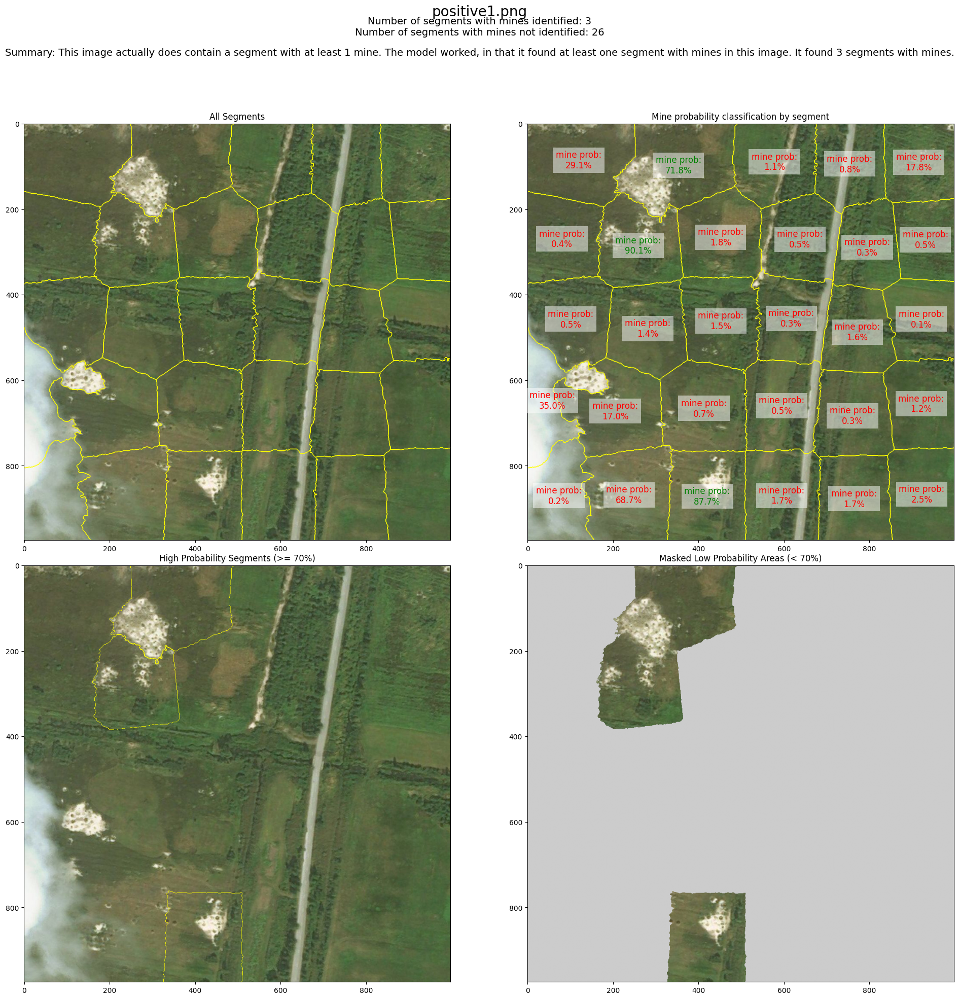

Number of segments: 30
Number of labels: 30


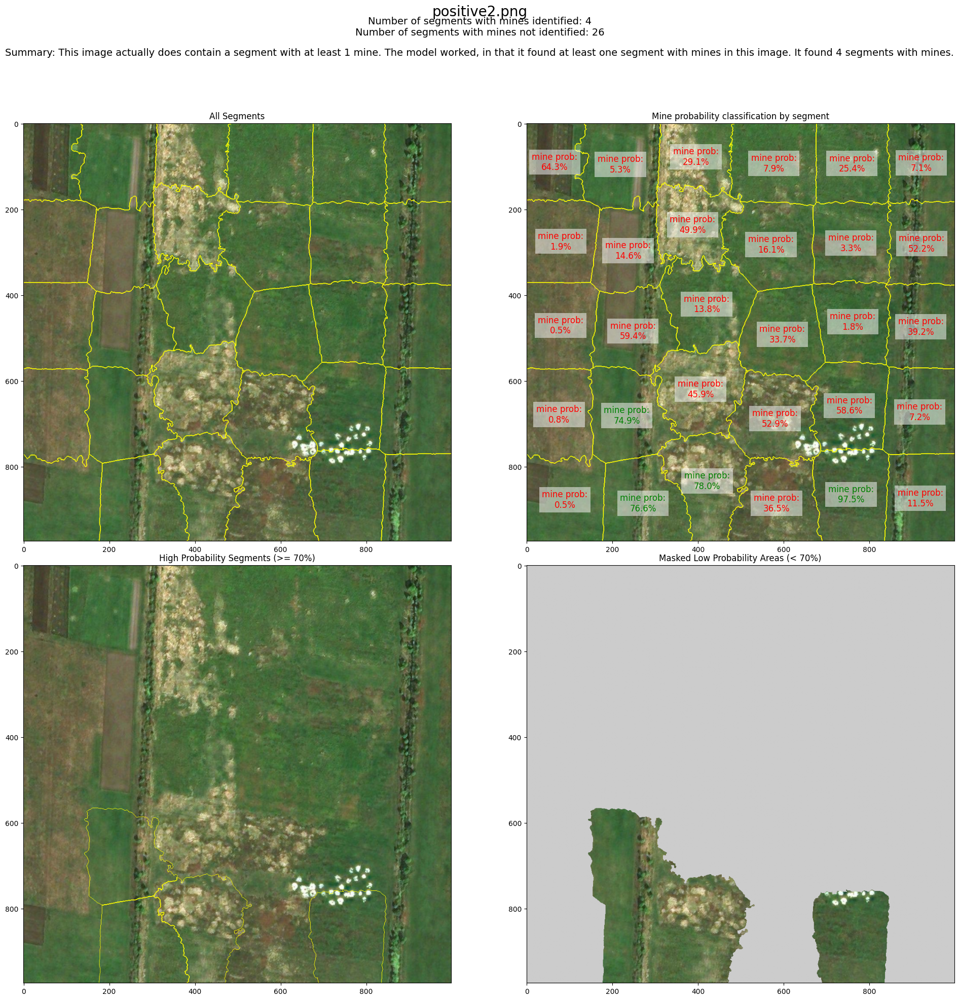

Number of segments: 29
Number of labels: 29


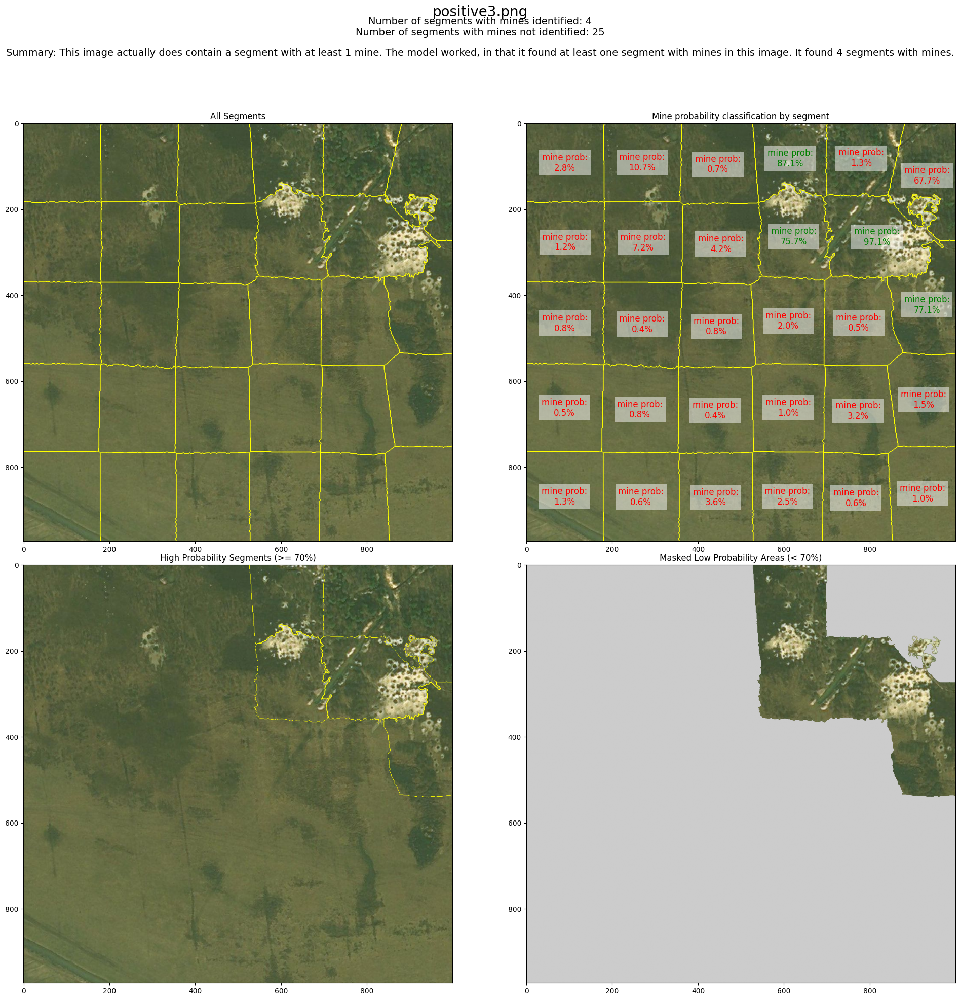

Number of segments: 30
Number of labels: 30


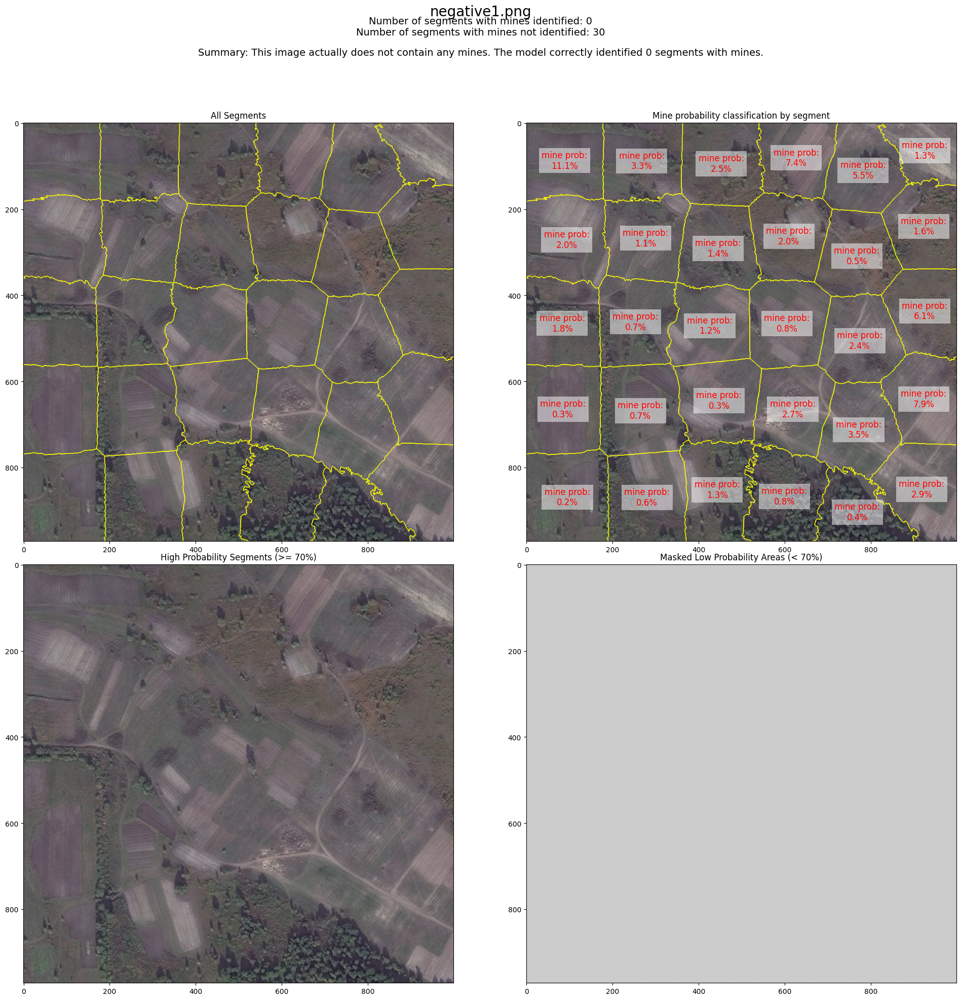

Number of segments: 30
Number of labels: 30


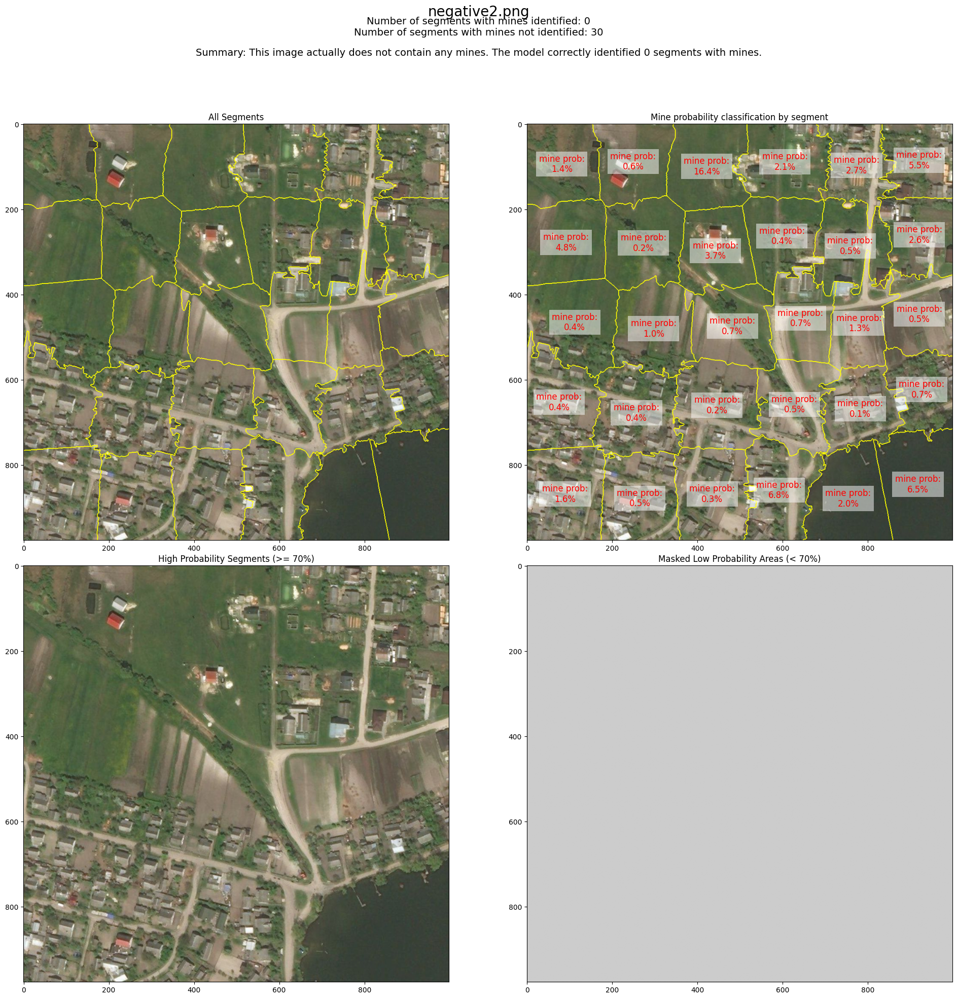

Number of segments: 30
Number of labels: 30


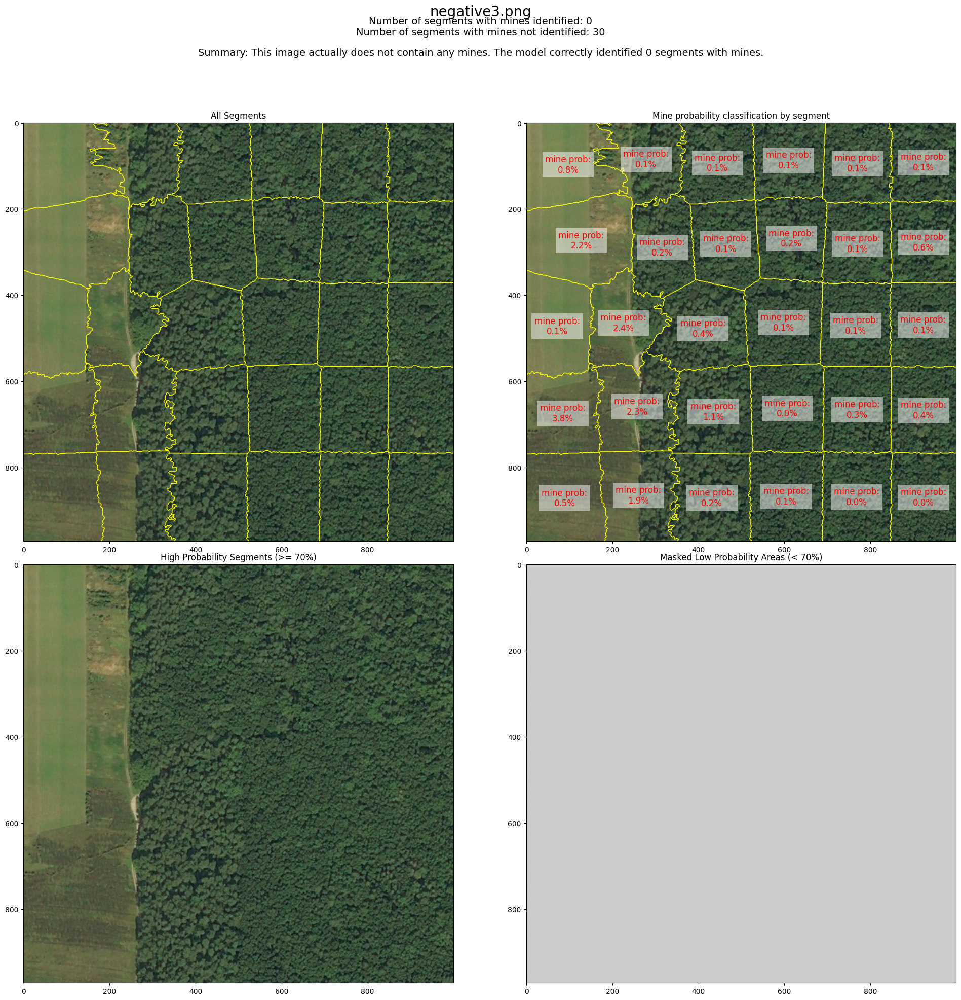

In [59]:
import os

# Define the folder path
folder_path = "./datasets/example"

# List of files
file_list = [
    "positive1.png",
    "positive2.png",
    "positive3.png",
    "negative1.png",
    "negative2.png",
    "negative3.png"
]

# Prepend the folder path to each file name
file_list = [os.path.join(folder_path, file) for file in file_list]

# Assuming _clf and resnet are defined elsewhere in your code
# _clf = ...
# resnet = ...

# Function to process each image
def process_image(img_name, _clf, resnet):
    # Construct labels using search_in_tile
    labels = search_in_tile(img_name, _clf, resnet)

    # Read and preprocess the image
    img = io.imread(img_name)  # image as numpy array
    original_image = Image.fromarray(img.astype('uint8'), 'RGB')  # same image as PIL object
    img = img_as_float(img)  # convert to float, to use for segmentation purposes

    # Split image into segments
    segments_slic = slic(img, n_segments=30, compactness=35, sigma=1)  # split image to segments
    marked_img_all = mark_boundaries(img, segments_slic)  # image with all segments and boundaries

    # Find label values for each segment without amber
    negative_labels = [i + 1 for i, l in enumerate(labels) if l == 0]  # assuming 0 is negative

    # Create a copy of segments_slic for positive segments
    segments_slic_positive = segments_slic.copy()

    # Filter out from our mask all pixels with values for "negative" segments
    segments_slic_positive[np.isin(segments_slic_positive, negative_labels)] = 0

    # Mark boundaries for positive segments
    marked_img_positive = mark_boundaries(img, segments_slic_positive)  # new image has only boundaries for positive segments

    # Show images in a 2x2 grid
    fig, ((ax0, ax1), (ax2, ax3)) = plt.subplots(nrows=2, ncols=2, figsize=(20, 20))
    filename = os.path.basename(img_name)
    fig.suptitle(f"{filename}", fontsize=20)  # Add the image name as a title above the plots

    ax0.imshow(marked_img_all)
    ax0.set_title("All Segments")
    ax1.imshow(marked_img_positive)
    ax1.set_title("Mine probability classification by segment")

    # Debugging information
    segments_info = regionprops(segments_slic)
    print(f"Number of segments: {len(segments_info)}")
    print(f"Number of labels: {len(labels)}")

    # Ensure the number of labels matches the number of segments
    if len(labels) < len(segments_info):
        labels.extend([-1] * (len(segments_info) - len(labels)))  # Add placeholder labels for missing segments

    # Create a mask for segments with mine probability >= 70%
    segments_slic_high_prob = segments_slic.copy()
    high_prob_count = 0
    low_prob_count = 0
    for i, segment in enumerate(segments_info):
        label = labels[i]
        centroid = segment.centroid
        # Multiply by 100, round to 1 decimal place, and add percentage and text
        percentage = round(label * 100, 1)
        label_text = f"mine prob:\n{percentage}%"
        # Set color based on percentage
        color = 'green' if percentage >= 70 else 'red'
        ax1.text(centroid[1], centroid[0], label_text, color=color, fontsize=12, ha='center', va='center', bbox=dict(facecolor='white', alpha=0.5, edgecolor='none'))
        # Filter out segments with probability < 70%
        if percentage >= 70:
            high_prob_count += 1
        else:
            low_prob_count += 1
            segments_slic_high_prob[segments_slic == (i + 1)] = 0

    # Mark boundaries for high probability segments
    marked_img_high_prob = mark_boundaries(img, segments_slic_high_prob)
    ax2.imshow(marked_img_high_prob)
    ax2.set_title("High Probability Segments (>= 70%)")

    # Mask areas below 70% with solid light grey
    masked_img = img.copy()
    masked_img[segments_slic_high_prob == 0] = [0.8, 0.8, 0.8]  # light grey color
    ax3.imshow(masked_img)
    ax3.set_title("Masked Low Probability Areas (< 70%)")

    # Add subheading with counts
    fig.text(0.5, 0.95, f"Number of segments with mines identified: {high_prob_count}\nNumber of segments with mines not identified: {low_prob_count}", ha='center', fontsize=14)

    # Add summary based on filename
    if "negative" in filename.lower():
        if high_prob_count == 0:
            summary = "This image actually does not contain any mines. The model correctly identified 0 segments with mines."
        else:
            summary = f"This image actually does not contain any mines. The model incorrectly identified {high_prob_count} segments with mines."
    elif "positive" in filename.lower():
        if high_prob_count > 0:
            summary = f"This image actually does contain a segment with at least 1 mine. The model worked, in that it found at least one segment with mines in this image. It found {high_prob_count} segments with mines."
        else:
            summary = "This image actually does contain a segment with at least 1 mine. The model incorrectly predicted that there are no segments with mines in this picture."
    else:
        summary = ""

    fig.text(0.5, 0.93, f"Summary: {summary}", ha='center', fontsize=14)

    fig.tight_layout(rect=[0, 0, 1, 0.90])  # Adjust layout to make room for the title and subheading
    plt.show()

# Loop through the file_list and process each image
for file in file_list:
    process_image(file, _clf, resnet)

#### Such a great joy! Our method works, we can find footprints of amber mining on satellite images. 

So we used this method to search satellite images for the area of ~70,000 square km.

Please, read our [project about amber mining in English](http://texty.org.ua/d/2018/amber_eng).

The article has interactive map for all places of illegal amber mining, found by method described in this code 